The sensitivity of an option to a change in a parameter can be found by finding the partial derivative of the Black-Scholes option pricing formula. These partial derivatives are referred to collectively as "The Greeks", as each derived equation is represented by a Greek letter. The Delta, $\Delta$, Greek, is the partial derivative of the Black-Scholes model with respect to $S$, the underlying asset's price.

### The Black-Scholes Model

As described in a [previous post on the generalized Black-Scholes equation](https://aaronschlegel.me/black-scholes-formula-python.html), the generalized pricing formula for an European call and put option, respectively, are defined as:

$$ C(S, t) = Se^{T(b-r)} N(d_1) - Ke^{-rT} N(d_2) $$

$$ P(S, t) = Ke^{-rT} N(-d_2) - Se^{T(b-r)} N(-d_1) $$

Where $C(S,t)$ is the value at time $t$ of a call option and $P(S,t)$ is the value at time $t$ of a put option. The parameters of the model are defined as:

* $S$, the spot price of the asset at time $t$
* $T$, the maturity of the option. Time to maturity is defined as $T - t$
* $K$, strike price of the option
* $r$, the risk-free interest rate, assumed to be constant between $t$ and $T$
* $\sigma$, volatility of underlying asset, the standard deviation of the asset returns
* $b$, cost-of-carry rate, where:
  * $b = r$
    - Black-Scholes model for European stock options
  * $b = r - q$
    - Merton's extension to the model for pricing European stock options with a continuous dividend yield and stock indexes
  * $b = 0$
    - Black Fischer's extension for pricing European futures options
  * $b = r - r_j$ 
    - Model for pricing European currency options

$N(d)$ is the [normal cumulative distribution function](https://en.wikipedia.org/wiki/Normal_distribution#Cumulative_distribution_function) for a standard normal variable (zero mean, one standard deviation), which is defined as:

$$N(d) = \frac{1}{\sqrt{2\pi}} \int_{-\infty}^d e^{-\frac{1}{2}x^2} dx$$

Therefore, $d_1$ and $d_2$ are defined as, respectively:

$$ d1 = \frac{ \ln \left( \frac{S}{K} \right) + T \left(b + \frac{\sigma^2}{2} \right)}{\sigma \sqrt{T}} $$

$$ d2 = d1 - \sigma \sqrt{T} $$

### Delta, $\Delta$

To find the delta equation for an European put and call option, we find the partial derivatives of the above Generalized Black-Scholes model with respect to $S$. Skipping over the intermediate steps, we arrive at:

$$ \Delta_{call} = \frac{\partial c}{\partial S} = e^{T(b-r)} N(d_1) > 0 $$

$$ \Delta_{put} = \frac{\partial p}{\partial S} = e^{T(b-r)} \left[N(d_1) - 1 \right] < 0 $$

In [304]:
import plotly.graph_objects as go
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats
import sympy
import seaborn as sns
from sympy.stats import Normal, cdf
from sympy import init_printing
from mpl_toolkits import mplot3d
init_printing()
%matplotlib inline

In [290]:
def delta(s, k, t, b, r, sigma, option='call', exact=False):
    if option not in ('call', 'put'):
        raise ValueError('option parameter must be one of "call" (default) or "put".')
    
    if exact:
        d1 = (sympy.ln(s / k) + t * (b + sigma ** 2 / 2)) / (sigma * sympy.sqrt(t))
        
        n = Normal("x", 0.0, 1.0)
        
        if option == 'call':
            d = sympy.exp(t * (b - r)) * cdf(n)(d1)
        if option == 'put':
            d = sympy.exp(t * (b - r)) * (cdf(n)(d1) - 1)
    
    else:
        d1 = (np.log(s / k) + t * (b + sigma ** 2 / 2)) / (sigma * np.sqrt(t))

        if option == 'call':
            d = np.exp(t * (b - r)) * stats.norm.cdf(d1, 0.0, 1.0)
        if option == 'put':
            d = np.exp(t * (b - r)) * (stats.norm.cdf(d1, 0.0, 1.0) - 1)
        
    return d

In [292]:
t = 0.5
s = 105
k = 100
r = 0.10
b = 0
sigma = 0.36

In [293]:
print(delta(s, k, t, b, r, sigma))
print(delta(s, k, t, b, r, sigma, 'put'))

0.5946286597299957
-0.35660076477071834


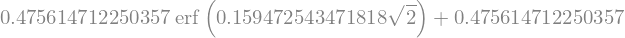

In [295]:
delta(s, k, t, b, r, sigma, exact=True)

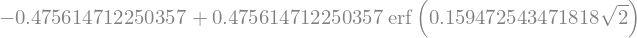

In [296]:
delta(s, k, t, b, r, sigma, option='put', exact=True)

In [302]:
t =  np.linspace(30, 700, 500) #np.repeat(0.05, 500)
s = np.linspace(30, 200, 500)
t1 = np.linspace(1, 100, 500)
s1 = np.repeat(105, 500)
k = 100
r = 0.07
b = 0.04
sigma = 0.30

d = delta(s, k, t, b, r, sigma)
d1 = delta(s1, k, t1, b, r, sigma)

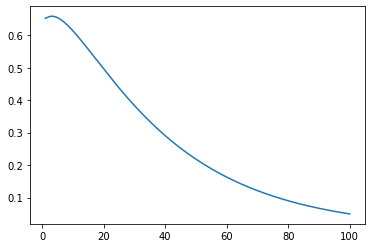

In [303]:
sns.lineplot(t1, d1)

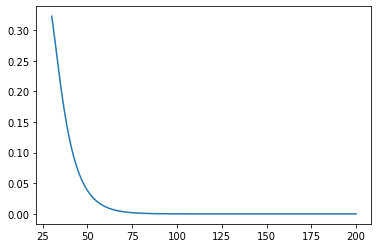

In [299]:
sns.lineplot(s, d)

In [300]:
ss, tt = np.meshgrid(s, t)
de = delta(ss, k, tt, b, r, sigma)

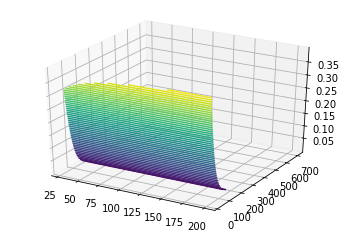

In [306]:
fig = plt.figure()
ax = plt.axes(projection='3d')
ax.contour3D(ss, tt, de, 50)

In [301]:
fig = go.Figure(data=[go.Surface(z=de, y=tt, x=ss)])

fig.update_layout(
    scene = dict(
        xaxis = dict(nticks=10, range=[180, 10],),
                     yaxis = dict(nticks=10, range=[150, 10],),
                     zaxis = dict(nticks=10, range=[0,1],),),
    width=700,
    margin=dict(r=10, l=5, b=5, t=5))

fig.show()

### DdeltaDvol

In [97]:
def ddeltadvol(s, k, t, b, r, sigma):
    
    d1 = (np.log(s / k) + t * (b + sigma ** 2 / 2)) / (sigma * np.sqrt(t))
    d2 = d1 - sigma * np.sqrt(t)
    
    d = (-np.exp((b-r) * t) * d2) / sigma * stats.norm.pdf(d1, 0.0, 1.0)
    
    return d

In [30]:
s = 90
k = 80
t = 0.25
r = 0.05
b = 0.05
sigma = 0.20

In [31]:
ddeltadvol(s, k, t, b, r, sigma)

-1.0008300136144481

In [98]:
t = np.linspace(500, 1, 100)
s = np.linspace(200, 10, 100)
k = 100
r = 0.05
b = 0.00
sigma = 0.20

ss, tt = np.meshgrid(s, t)
de = ddeltadvol(ss, k, tt, b, r, sigma)

In [100]:
fig = go.Figure(data=[go.Surface(z=de, x=ss, y=tt)])

fig.update_layout(
    scene = dict(
        xaxis = dict(nticks=10, range=[150, 50],),
                     yaxis = dict(nticks=10, range=[400,100],),
                     zaxis = dict(nticks=10, range=[-.5,.5],),),
    width=700,
    margin=dict(r=20, l=10, b=10, t=10))

fig.show()